# Introduction

*Sunrise, sunset*<br>
*Sunrise, sunset*<br>
*Swiftly flow the days…*<br>


Through word-of-mouth and experience, everyone has a general idea of the best place in town to view a sunrise or sunset. Terra Modern wanted to do a low-stakes open source GIS project to brush up on our skills, so we decided to conduct a data-driven site suitability analysis that identifies the PERFECT place in Leon County to view a sunrise or sunset. The analysis is loosely based on a [tutorial by Scott Culotta](http://www.geo.utexas.edu/courses/371c/project/2019F/Culotta_GIS_Project.pdf) that uses ESRI software to find the best views in Cuyahoga County, Ohio. (Thanks for the idea, Scott!)

But don’t worry: we’ll be using public data and open source software that can be freely downloaded by anyone, anytime, anywhere. This first post will give an overview of the data sources, the software needed to do the analysis, and the data processing steps. Our goal is to not only identify the best spots in Leon County to view a sunrise or sunset, but also to make sure that anyone reading this blog can repeat the analysis for their area of interest.

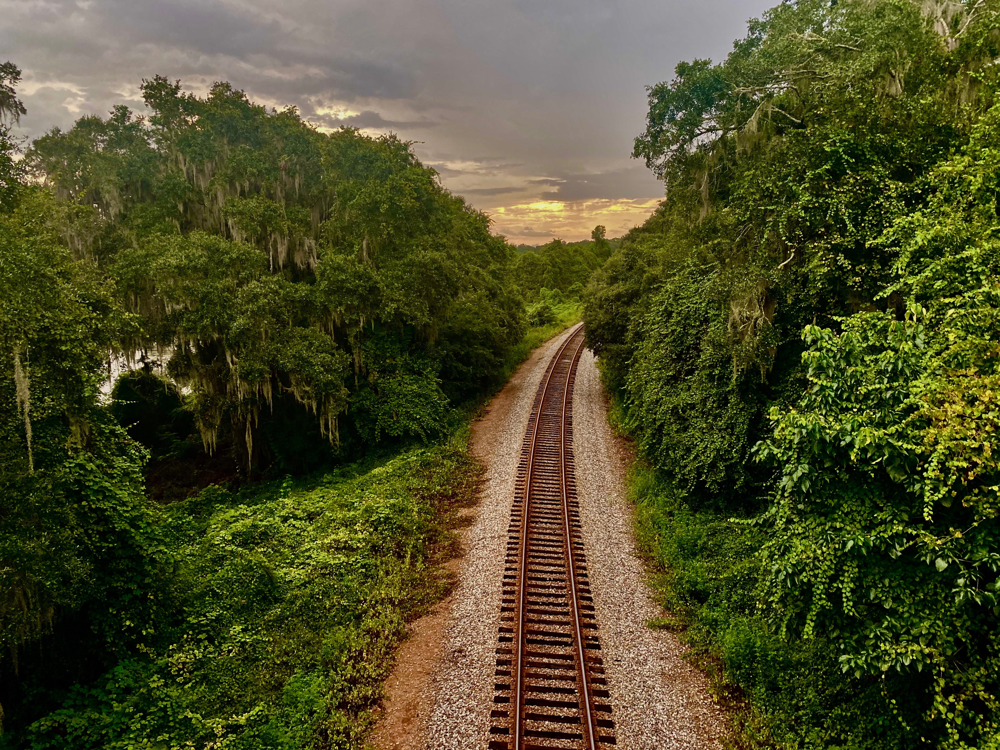

Data Sources
One of the upsides of living in Florida is that citizens can take advantage of [Florida’s Sunshine Law](http://www.leg.state.fl.us/statutes/index.cfm?App_mode=Display_Statute&URL=0200-0299/0286/0286ContentsIndex.html&StatuteYear=2012&Title=-%3E2012-%3EChapter%20286), where state government agencies are required to give the public basic access to their meetings and records. This means that most Florida data is open and free for the taking! Data for this project was acquired from the Florida Geographic Data Library (FGDL)(https://www.fgdl.org/download/index.html), which hosts what may well be every geographic dataset imaginable from federal and Florida state agencies. For locally maintained datasets, we downloaded data from the Tallahassee-Leon County GeoData Hub (https://geodata-tlcgis.opendata.arcgis.com/). Initially, we downloaded nearly 20 different datasets to account for practically every obstacle in the viewshed, including FM/AM/Radio/Cellular towers, building footprints, and cadastral data, but after a few trial and error runs we determined that these ancillary datasets weren’t needed. Remember folks: when in doubt, KISS! [keep it simple, stupid]. In the end, for our Leon County sunrise/sunset suitability analysis we determined that we would only need the following datasets:
A Leon County boundary dataset to clip our other layers to the area of interest. 
A Land Use/Land Cover dataset to eliminate any land use areas we deemed unsuitable for viewing a sunrise or sunset situation. I mean, can you even properly watch a sunset in a dense forest?
The Florida Land Managed Areas (FLMA) dataset which shows the location of all publicly maintained lands in Florida. This dataset is maintained by the Florida Natural Areas Inventory (FNAI)(https://www.fnai.org/) and will come in handy for identifying the best parks from which to view that giant glowing ball in the sky.
Elevation data for Leon County in the form of a digital elevation model (DEM), which will be used to identify east- and west-facing slopes. The raster we used has a resolution of 1 arc-second, or approximately 30 meters from north to south.
Layer Name
Data Type
Source
Date
Purpose
Link
Florida Land Managed Areas (FLMA)
Vector-Polygon
Florida Natural Areas Inventory
2020
Best View
https://www.fgdl.org/metadataexplorer/explorer.jsp
Land Use/Land Cover (Northwest Florida)
Vector-Polygon
Florida Geographic Data Library
2016
Best View
https://www.fgdl.org/metadataexplorer/explorer.jsp
Leon County Boundary
Vector-Polygon
Tallahassee-Leon county GIS
2020
Clip data to Leon county 
geodata-tlcgis.opendata.arcgis.com


Leon County Digital Elevation Model
Raster
USGS
2019
Aspect and Viewshed Analysis
https://www.sciencebase.gov/catalog/item/5df04e46e4b02caea0f4f736
and 
https://www.sciencebase.gov/catalog/item/5bdcf34de4b0b3fc5cf1167d


DEM Acquisition

The USGS connects users with national raster data via their National Map Viewer app (https://apps.nationalmap.gov/downloader/), but you can download the Leon County data either from our geopackage or from the links provided above. If you have a different study area in mind, or you’re looking for a practice in patience, go to the National Map Viewer app and zoom into your area of interest. On the left-hand menu,  specify 3DEP (3D Elevation program) 1 arc-second resolution Elevation Products, then click ‘Search Products’. You’ll be able to scroll through the results and preview footprints as well as thumbnails of the images. When you find a raster you’d like to download, you can just click ‘Download ZIP’ (some rasters will have the option ‘Download TIF’ instead) and wait approximately 8 minutes for your shiny new digital elevation model! 


Geopackage on Github link (https://github.com/Terra-Modern/SunriseSunset) (They’ll need to clone the repository)

Computing Environment and Data Processing
We’ll be using QGIS (https://www.qgis.org/en/site/), a free and open source cross-platform desktop geographic information system (GIS) application that supports the viewing, editing, and analysis of geospatial data. You can download it here: https://qgis.org/en/site/forusers/download.html
If you’ve never used QGIS before, this article over at the GIS Lounge lists seven metric tons of free resources to help you get started. 

Once you have QGIS open and ready to go, I recommend adding all your layers to QGIS so you can visually inspect them, as well as do a quick QAQC of the attributes in each layer. Here I’ve added all the vector layers (FLMA, Land Use/Land Cover, and Leon county boundary) to my QGIS project.




Here’s the DEM with the Leon County boundary overlain for reference:  


Once you’ve confirmed that all your datasets appear to be in working order and that they have the attributes you need, you can proceed to the following data preprocessing steps:

Reproject your vector data
Because we’re situated in beautiful north Florida, are using a DEM with elevations in meters, and are alive after 2011, we decided that the NAD83 (2011) / Florida North (EPSG: 6440)(https://epsg.io/6440) projection made the most sense to use for our study area.

I always recommend reprojecting vector data FIRST, before completing any other data preprocessing steps. This can be easily done in QGIS using the ‘Reproject Layer’ tool found in the Vector > Data Management Tools toolbox. After opening the tool, simply add the layer you wish to project and use the Coordinate Reference System Selector to select the target projection (in our case, EPSG:6440). Once you’ve selected your projection, hit ‘OK.’ Make sure the tool will save your reprojected layer to a directory of your choice, then click ‘Run.’ Do this for all your vector layers, then proceed to the next step. 


Clip your vector data 
Now that all your layers are reprojected, we can move on to the next data preprocessing step: clipping each layer to the area of interest represented by the ‘Leon County Boundary’ layer. First, open the ‘Clip’ tool in the Vector > Geoprocessing Tools toolbox and input the layer you want clipped into the ‘Input layer.’ Then add the boundary layer as the ‘Overlay layer’ and save the output ‘Clipped’ dataset to the directory of your choice. Run the tool. Do this for all the layers you wish to include in your site suitability analysis. 




And ouila! The image below represents all our vector layers reprojected and clipped. That means we’re ready to conduct our analysis for identifying the perfect sunrise or sunset in Leon County.



Merge rasters
Since we’re only working with two rasters and they cover a relatively small but contiguous area, my preference is to merge the images before reprojecting or clipping to the extent of the county. Technically speaking, I prefer it this way because I can avoid seam lines between the rasters when they’re reprojected. Lazily speaking, I don’t want to work with two separate files because I don’t want to do the same operations twice. If you’re of the same mindset, start by adding both rasters to your project. Click ‘Raster’ on the toolbar menu across the top of the QGIS screen > ‘Miscellaneous’ > ‘Merge’. In the Merge tool pop-up, clicking the ellipses next to the ‘Input layers’ will open a window where you can select all data that you want to merge. Select both rasters, provide an output location for the new dataset, and click ‘Run’. 

Before merging: 

After merging:

Points to you if you can spot all five differences between these two images! (Hint: I’m kidding and there are 0 differences.) 

Reproject (“Warp”) raster  
Now that the raster data is in one cohesive layer, it can be re-projected to NAD83 (2011) / Florida North (EPSG: 6440) like the vector data. Unlike vector data, reprojecting raster data requires the “Warp” tool. To access the Warp tool, click ‘Raster’ > ‘Projections’ > ‘Warp (Reproject)’. In the pop-up window, select the raster layer you’d like to reproject from the drop-down menu. Select the “Target CRS”, provide an output location and name, and click ‘Run’. 


Clip/Extract raster by mask
“Clip by mask” is basically the same as clipping, but for raster data. The “mask” referenced in the tool name is the same Leon County boundary layer that was used to clip the vector data in a previous step. Navigate to the tool by clicking ‘Raster’ > ‘Extraction’ > ‘Clip raster by mask layer’. For ‘Input layer’, select your raster. For ‘Mask layer’, select the Leon County boundary layer. After specifying the output location, click ‘Run’.  The resulting image will probably look something like this:

There are ways to remove the black border or make it invisible, but it won’t affect the analysis if it’s left as is.  
Speaking of... we’re now ready to conduct our analysis for identifying the perfect sunrise or sunset in Leon County. 
